In [1]:
# ------- TEST function of mapping --------- # 

import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import os
import matplotlib.dates as mdates
import cmocean as cm
import glob
import os
import waypoint_distance as wd
%matplotlib widget

def plot_multiple_missions_map(glider_files, long_bounds=None, lat_bounds=None,
                               topo_file=os.path.expanduser('~/Desktop/british_columbia_3_msl_2013.nc')):
    """
    Plot multiple glider paths over bathymetry for the Calvert Line.

    Parameters:
    - glider_files: list of str, paths to NetCDF glider grid files
    - topo_file: str, path to topo NetCDF file
    - long_bounds, lat_bounds: optional map bounds
    """

    # Load all datasets
    datasets = [xr.open_dataset(os.path.expanduser(f)) for f in glider_files]
    all_lons = np.concatenate([ds['longitude'].values for ds in datasets])
    all_lats = np.concatenate([ds['latitude'].values for ds in datasets])

    # Auto bounding box if not provided
    if long_bounds is None:
        long_bounds = [all_lons.min() - 0.5, all_lons.max() + 0.5]
    if lat_bounds is None:
        lat_bounds = [all_lats.min() - 0.5, all_lats.max() + 0.5]

    # Load topo and subset
    topo = xr.open_dataset(topo_file)
    topo = topo.sel(
        lon=slice(long_bounds[0], long_bounds[1]),
        lat=slice(lat_bounds[0], lat_bounds[1])
    )
    topo_var = -topo['Band1']

    # Set up plot
    fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent(long_bounds + lat_bounds, crs=ccrs.PlateCarree())

    # Gridlines with lat/lon ticks only
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0)
    gl.top_labels = False
    gl.right_labels = False

    # Bathymetry shading
    levels = np.linspace(0, 410, 51)
    contourf = ax.contourf(topo['lon'], topo['lat'], topo_var,
                           levels=levels, cmap=cm.cm.deep, extend='both')
    fig.colorbar(contourf, ax=ax, label='Depth (m)')

    # 0 m contour (coastline)
    ax.contour(topo['lon'], topo['lat'], topo_var, levels=[0.5], colors='black', linewidths=1)

    # Time scaling for consistent colorbar
    all_time_vals = np.concatenate([ds['time'].values for ds in datasets])
    all_time_nums = mdates.date2num(all_time_vals)
    vmin = all_time_nums.min()
    vmax = all_time_nums.max()

    for i, ds in enumerate(datasets):
        lons = ds['longitude'].values
        lats = ds['latitude'].values
        time_vals = ds['time'].values
        time_nums = mdates.date2num(time_vals)

        label = os.path.basename(glider_files[i]).split('_')[0]
        sc = ax.scatter(lons, lats, c=time_nums, cmap='seismic',
                        vmin=vmin, vmax=vmax, s=5, transform=ccrs.PlateCarree(),
                        zorder=5, label=label)

    # Colorbar
    cbar = plt.colorbar(sc, ax=ax, orientation='vertical', pad=0.01, extend='both')
    cbar.set_label('Date')
    cbar.ax.yaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))

    # Waypoint track overlay (optional)
    waypoint_lon = [-127.950, -128.115, -128.243, -128.514, -128.646, -128.798]
    waypoint_lat = [51.757, 51.705, 51.715, 51.450, 51.4165, 51.408]
    # ax.plot(waypoint_lon, waypoint_lat, color='black', linestyle='-', linewidth=2, label='Transect')

    ax.legend(title='Glider Missions')
    ax.set_title('Glider Missions Map')
    ax.set_aspect(1 / np.cos(np.deg2rad(np.mean(lat_bounds))))

# Function to compare glider data:
def plot_comparison_map(original_file, reprocessed_file,
                        long_bounds=None, lat_bounds=None,
                        topo_file=os.path.expanduser('~/CalvertLine/smith_sandwell_topo_v8_2.nc')):
    """
    Plot original vs reprocessed glider path on a topo map.

    Parameters:
    - original_file: str, path to original _grid_delayed.nc file
    - reprocessed_file: str, path to reprocessed _grid_delayed.nc file
    - long_bounds, lat_bounds: optional map bounds
    - topo_file: str, path to Smith & Sandwell topo NetCDF
    """
    import xarray as xr
    import matplotlib.pyplot as plt
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature
    import numpy as np
    import os
    import cmocean

    # Load datasets
    ds_old = xr.open_dataset(os.path.expanduser(original_file))
    ds_new = xr.open_dataset(os.path.expanduser(reprocessed_file))

    # Autoscale bounds if needed
    all_lons = np.concatenate([ds_old.longitude.values, ds_new.longitude.values])
    all_lats = np.concatenate([ds_old.latitude.values, ds_new.latitude.values])

    if long_bounds is None:
        long_bounds = [all_lons.min() - 0.5, all_lons.max() + 0.5]
    if lat_bounds is None:
        lat_bounds = [all_lats.min() - 0.5, all_lats.max() + 0.5]

    # Load topo
    topo = xr.open_dataset(topo_file)
    topo = topo.sel(
        longitude=slice(long_bounds[0] + 360, long_bounds[1] + 360),
        latitude=slice(lat_bounds[0], lat_bounds[1]))
    topo['longitude'] = topo['longitude'] - 360  # Convert to west longitudes

    # Set up map
    fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()}, constrained_layout=True)
    ax.set_extent(long_bounds + lat_bounds, crs=ccrs.PlateCarree())
    ax.coastlines(resolution='10m')
    gl = ax.gridlines(draw_labels=True, color='gray', linestyle='--', alpha=0.5)
    gl.top_labels = False
    gl.right_labels = False
    ax.set_aspect(1 / np.cos(np.deg2rad(np.mean(lat_bounds))))

    # Plot bathymetry
    topo_var = -topo['ROSE']
    levels = np.linspace(0, 400, 21)
    contour = ax.contourf(topo['longitude'], topo['latitude'], topo_var,
                          levels=levels, cmap=cmocean.cm.deep, extend='both')
    plt.colorbar(contour, ax=ax, label='Depth (m)')

    # Plot glider tracks in fixed colors
    ax.scatter(ds_old.longitude, ds_old.latitude, color='red', label='Original Track', s=5)
    ax.scatter(ds_new.longitude, ds_new.latitude, color='blue', label='Reprocessed Track', s=5)

    # Add waypoint transect (optional)
    waypoint_lon = [-127.950, -128.115, -128.243, -128.514, -128.646, -128.798]
    waypoint_lat = [51.757, 51.705, 51.715, 51.450, 51.4165, 51.408]
    # ax.plot(waypoint_lon, waypoint_lat, color='black', linestyle='--', linewidth=2, label='Waypoint Transect')

    # Extract glider name from file path
    glider_name = os.path.basename(original_file).split('_')[0]

    # Finalize plot
    ax.legend(title=f'Track Comparison for {glider_name}')
    plt.title(f'Original vs Reprocessed Glider Track: {glider_name}')

    plt.show()

In [2]:
# Loading all datasets (with wrong lat and long stuff)
file_dir = os.path.expanduser('~/CalvertLine/')
all_nc_files = sorted(glob.glob(os.path.join(file_dir, '*_grid_delayed.nc')))

array([ 2.40233905e+00, -2.05972628e+03,  2.90960114e+01, ...,
       -3.99294624e+02, -1.75407418e+02, -3.24357433e-02], shape=(1018,))

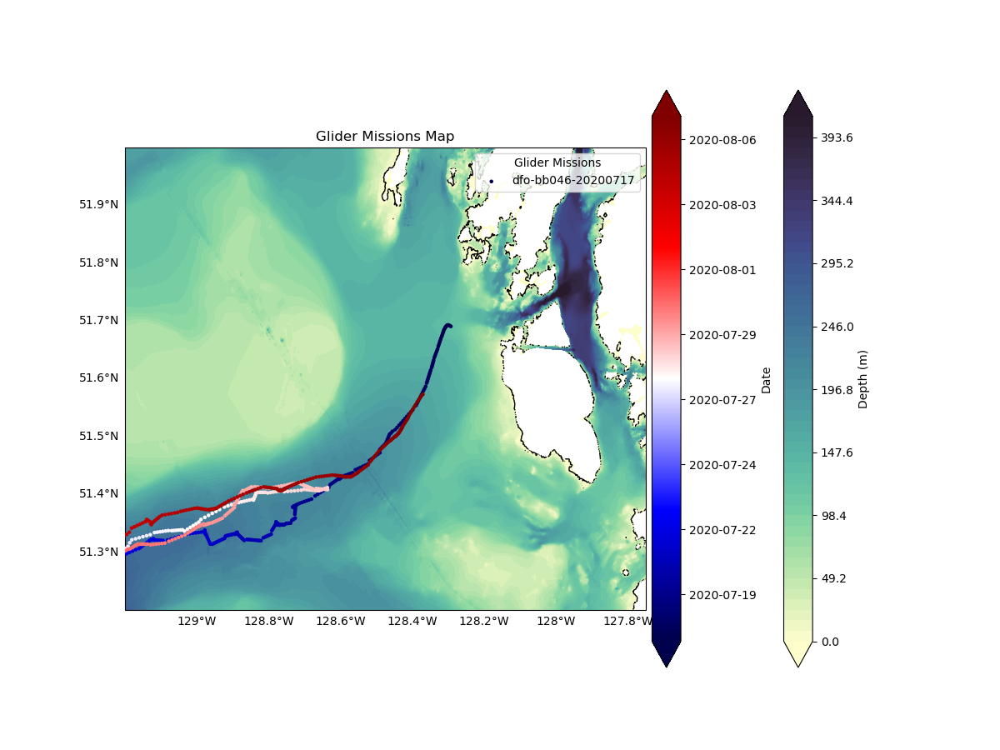

In [3]:
# Testing along data to see if it's suitable for plotting
def test_along(file_pathway):
    ds = xr.open_dataset(os.path.expanduser(file_pathway))
    waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
    waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
    alongx, acrossx, segment = wd.get_simple_distance(shiplon=ds['longitude'].values, shiplat=ds['latitude'].values, wplon=waypoint_lon, wplat=waypoint_lat, central_lat = 51.715)
    ds = ds.assign(along= (('time',), alongx))
    ds = ds.assign(across= (('time',), acrossx))

    plot_multiple_missions_map([file_pathway], lat_bounds = (51.2, 52 ), long_bounds = (-129.2, -127.75))
    along = ds['along'].values
    gradient_along = np.gradient(ds['along'].values)
    return along, gradient_along

file_pathway = ('~/CalvertLine/dfo-bb046-20200717_grid_delayed.nc')

along, gradient_along = test_along(file_pathway)
gradient_along

array([ 4.27227027e+02,  4.45023322e+02,  9.41740008e+02,  1.13686318e+03,
        1.38943119e+03,  1.41231157e+03,  1.19371722e+03,  1.11031129e+03,
        7.14142565e+02,  4.71043468e+02,  3.94837621e+02,  4.91920668e+02,
        4.73894499e+02,  4.27254109e+02,  3.75800104e+02,  3.48556533e+02,
        3.31406245e+02,  3.14412544e+02,  3.36002697e+02,  3.15277882e+02,
        2.52044524e+02,  2.39452135e+02,  8.37814611e+02,  7.70199317e+02,
        6.18332540e+01,  5.86718409e+01,  7.07996791e+01,  7.42656150e+01,
        6.24708315e+01,  6.87647119e+01,  6.35196018e+01,  4.29131056e+01,
        2.30700149e+01,  3.24683100e+01,  5.63855585e+01,  6.09559097e+01,
        8.00477589e+01,  1.24552873e+02,  1.41365194e+02,  1.39400941e+02,
        1.46539518e+02,  1.57983390e+02,  1.63827545e+02,  1.62981893e+02,
        1.89603388e+02,  2.16790174e+02,  2.16381745e+02,  2.14160159e+02,
        2.29222848e+02,  2.55182716e+02,  2.58249041e+02,  2.47974034e+02,
        2.67860303e+02,  

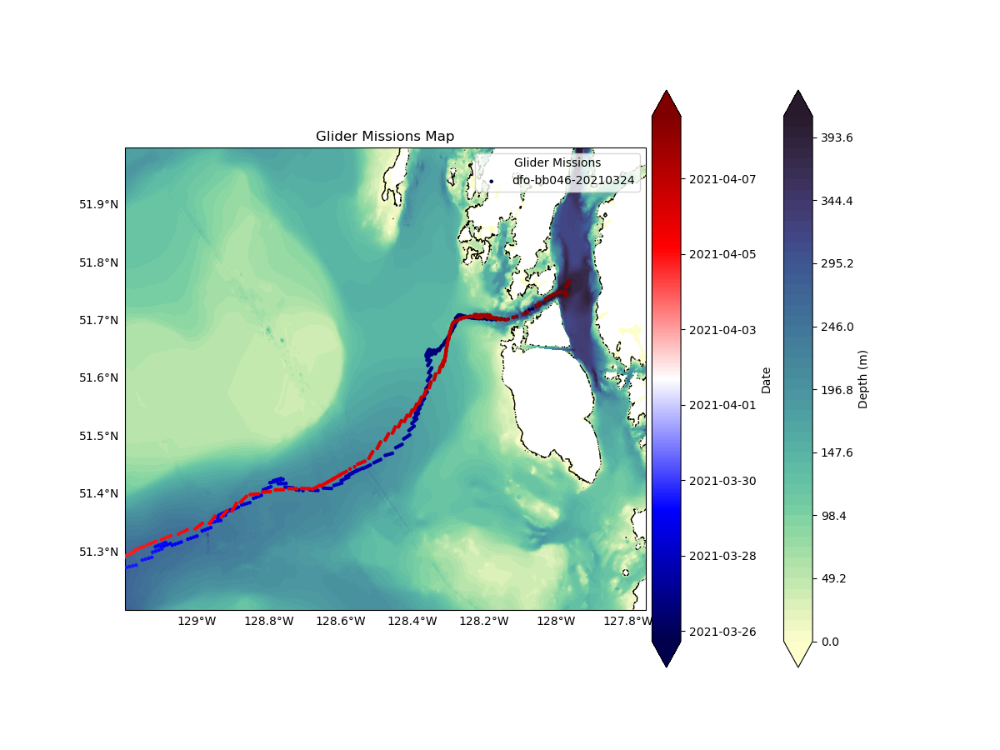

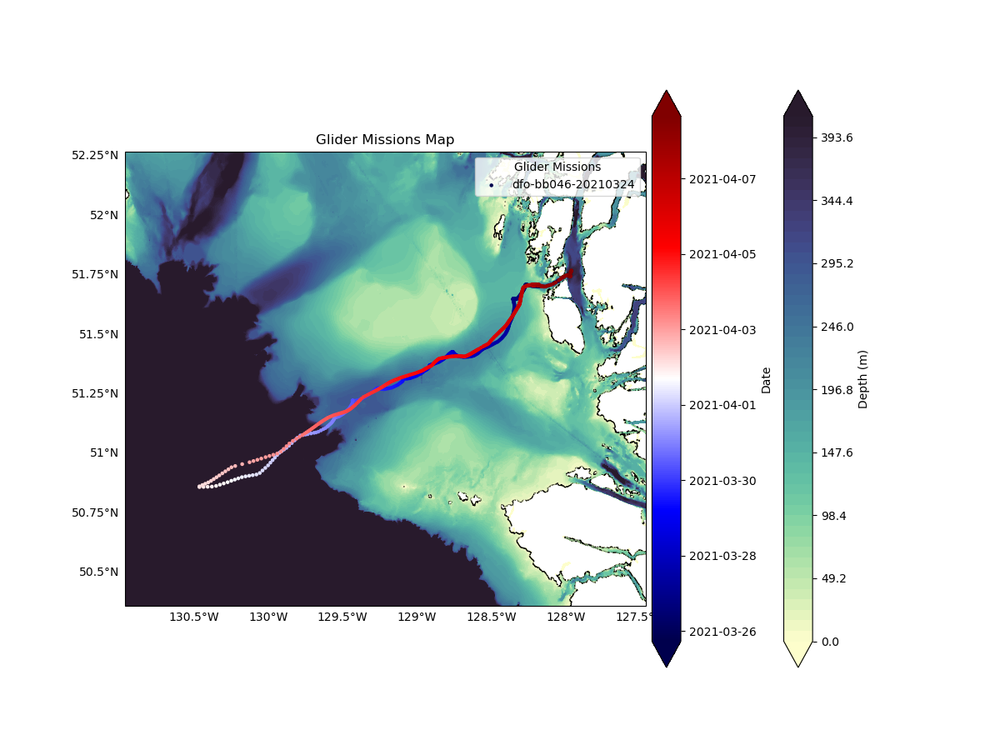

In [4]:
# Testing bb046 after Jody reprocessed it:
# Before  ------------

file_pathway = ('~/CalvertLine/dfo-bb046-20210324_grid_delayed.nc')
ds = xr.open_dataset(file_pathway)
plot_multiple_missions_map([file_pathway], lat_bounds=(51.2, 52), long_bounds=(-129.2, -127.75))

# After: ---------------
file_pathway = ('/Users/martinwilliamson/Desktop/dfo-bb046-20210324_grid_delayed.nc')
ds = xr.open_dataset(file_pathway)
plot_multiple_missions_map([file_pathway])

waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
central_lat = 51.715

# Get along/across transect distances
alongx, acrossx, _ = wd.get_simple_distance(
    shiplon=ds['longitude'].values,
    shiplat=ds['latitude'].values,
    wplon=waypoint_lon,
    wplat=waypoint_lat,
    central_lat=central_lat)

# Add to dataset
ds = ds.assign(along=('time', alongx))
ds = ds.assign(across=('time', acrossx))
gradient_along = np.gradient(alongx)
gradient_along

In [ ]:
# # More comparing:
# # First file processed by myself
#     # original_file='~/CalvertLine/dfo-bb046-20200717_grid_delayed.nc',
# plot_comparison_map(
#     original_file='/Users/martinwilliamson/Desktop/dfo-bb046-20200717_grid_delayed.nc', # testing to see if the website was updated with the changes I made, and it was. Crazy stuff but it worked. Cool.
#     reprocessed_file='~/CalvertLine_reprocessed/dfo-bb046-20200717_grid_delayed.nc',
#     lat_bounds=(51.2, 52),
#     long_bounds=(-129.2, -127.75))

# # file_pathway = ('~/CalvertLine_reprocessed/dfo-bb046-20200717_grid_delayed.nc')
# # ds = xr.open_dataset(file_pathway)
# # plot_multiple_missions_map([file_pathway], lat_bounds=(51.2, 52), long_bounds=(-129.2, -127.75))

# # waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
# # waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
# # central_lat = 51.715

# # # Get along/across transect distances
# # alongx, acrossx, _ = wd.get_simple_distance(
# #     shiplon=ds['longitude'].values,
# #     shiplat=ds['latitude'].values,
# #     wplon=waypoint_lon,
# #     wplat=waypoint_lat,
# #     central_lat=central_lat)

# # # Add to dataset
# # ds = ds.assign(along=('time', alongx))
# # ds = ds.assign(across=('time', acrossx))
# # gradient_along = np.gradient(alongx)
# # gradient_along

FileNotFoundError: [Errno 2] No such file or directory: '/Users/martinwilliamson/Desktop/dfo-bb046-20200717_grid_delayed.nc'

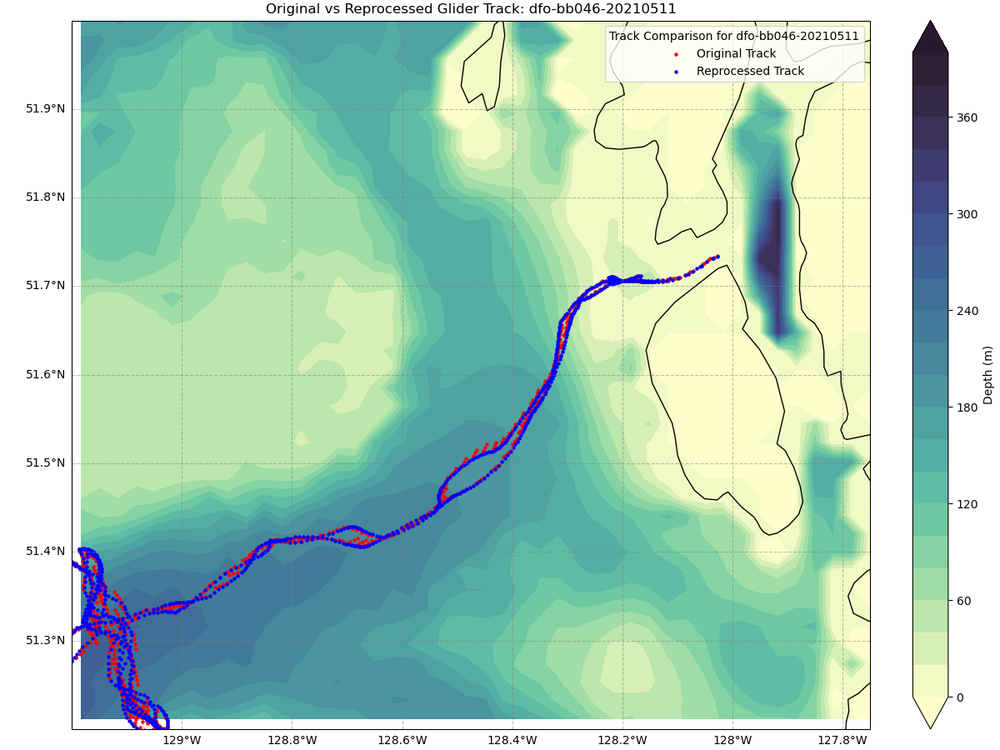

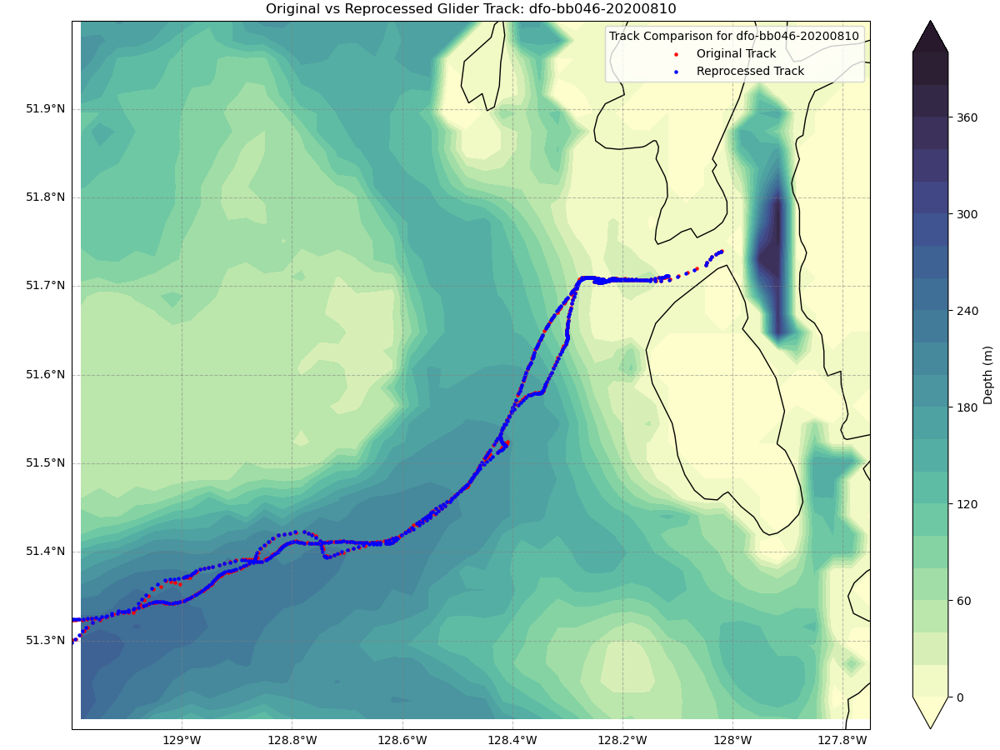

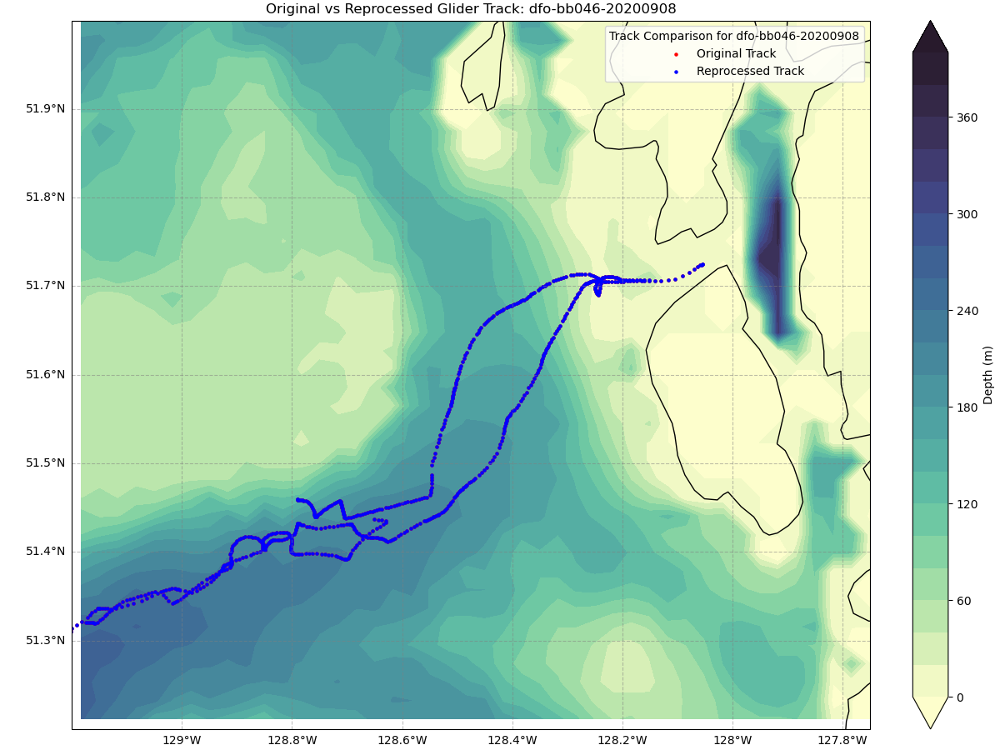

In [6]:
# More comparing:
# The one Jody did

plot_comparison_map(
    original_file='~/CalvertLine/dfo-bb046-20210511_grid_delayed.nc',
    reprocessed_file='~/CalvertLine_reprocessed/dfo-bb046-20210511_grid_delayed.nc',
    lat_bounds=(51.2, 52),
    long_bounds=(-129.2, -127.75))

# More comparing:
# The second one I did

plot_comparison_map(
    original_file='~/CalvertLine/dfo-bb046-20200810_grid_delayed.nc',
    reprocessed_file='~/CalvertLine_reprocessed/dfo-bb046-20200810_grid_delayed.nc',
    lat_bounds=(51.2, 52),
    long_bounds=(-129.2, -127.75))

# Third one I did:
plot_comparison_map(
    original_file='/Users/martinwilliamson/Desktop/dfo-bb046-20200908_grid_delayed.nc',
    reprocessed_file='~/CalvertLine_reprocessed/dfo-bb046-20200908_grid_delayed.nc',
    lat_bounds=(51.2, 52),
    long_bounds=(-129.2, -127.75))


# Reprocessed data: on a map #

array([ 4.27227027e+02,  4.45023322e+02,  9.41740008e+02,  1.13686318e+03,
        1.38943119e+03,  1.41231157e+03,  1.19371722e+03,  1.11031129e+03,
        7.14142565e+02,  4.71043468e+02,  3.94837621e+02,  4.91920668e+02,
        4.73894499e+02,  4.27254109e+02,  3.75800104e+02,  3.48556533e+02,
        3.31406245e+02,  3.14412544e+02,  3.36002697e+02,  3.15277882e+02,
        2.52044524e+02,  2.39452135e+02,  8.37814611e+02,  7.70199317e+02,
        6.18332540e+01,  5.86718409e+01,  7.07996791e+01,  7.42656150e+01,
        6.24708315e+01,  6.87647119e+01,  6.35196018e+01,  4.29131056e+01,
        2.30700149e+01,  3.24683100e+01,  5.63855585e+01,  6.09559097e+01,
        8.00477589e+01,  1.24552873e+02,  1.41365194e+02,  1.39400941e+02,
        1.46539518e+02,  1.57983390e+02,  1.63827545e+02,  1.62981893e+02,
        1.89603388e+02,  2.16790174e+02,  2.16381745e+02,  2.14160159e+02,
        2.29222848e+02,  2.55182716e+02,  2.58249041e+02,  2.47974034e+02,
        2.67860303e+02,  

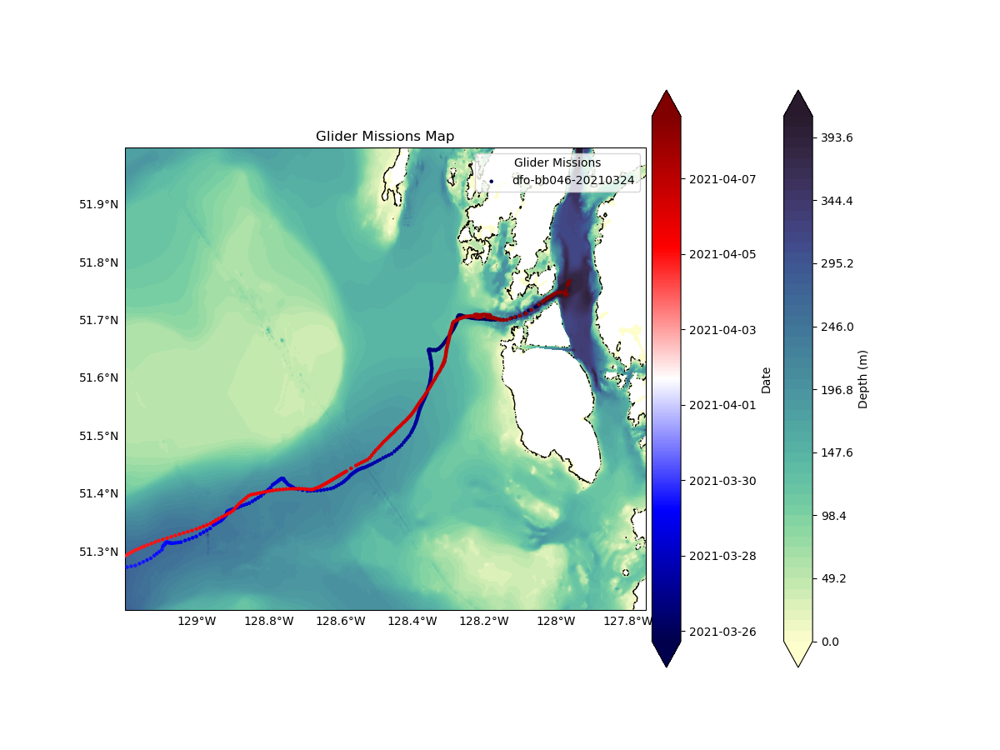

In [7]:
# plot_multiple_missions_map([
#     # '~/CalvertLine_reprocessed/dfo-bb046-20200717_grid_delayed.nc',
#     # '~/CalvertLine_reprocessed/dfo-bb046-20210511_grid_delayed.nc',
#     '~/CalvertLine_reprocessed/dfo-bb046-20210324_grid_delayed.nc',
#     # '~/CalvertLine_reprocessed/dfo-bb046-20200810_grid_delayed.nc',
#     # '~/CalvertLine_reprocessed/dfo-bb046-20200908_grid_delayed.nc',
#     ], lat_bounds=(51.4, 51.9), long_bounds=(-128.6, -127.8))

file_pathway = ('~/CalvertLine_reprocessed/dfo-bb046-20210324_grid_delayed.nc')
ds = xr.open_dataset(file_pathway)
plot_multiple_missions_map([file_pathway], lat_bounds=(51.2, 52), long_bounds=(-129.2, -127.75))

waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
central_lat = 51.715

# Get along/across transect distances
alongx, acrossx, _ = wd.get_simple_distance(
    shiplon=ds['longitude'].values,
    shiplat=ds['latitude'].values,
    wplon=waypoint_lon,
    wplat=waypoint_lat,
    central_lat=central_lat)

# Add to dataset
ds = ds.assign(along=('time', alongx))
ds = ds.assign(across=('time', acrossx))
gradient_along = np.gradient(alongx)
gradient_along

array([-2.53979276e+02, -9.22090885e+01, -7.27090886e+01, -2.37228483e-01,
        1.06025232e+02,  3.06622770e+02,  2.99154148e+02,  3.55715454e+02,
        3.24701760e+02,  2.19723737e+02,  2.00859350e+02,  2.05638017e+02,
        4.99709392e+02,  4.50159605e+02,  1.93014443e+02,  1.90107856e+02,
        3.46638131e+02,  2.40875903e+02,  1.49281755e+02,  2.82109496e+02,
        4.91796691e+02,  4.90972867e+02,  6.17336997e+02,  6.01798303e+02,
        4.41491874e+02,  4.34156292e+02,  9.05472830e+02,  8.61466715e+02,
        4.57253689e+02,  4.30135267e+02,  4.60074272e+02,  5.91374662e+02,
        4.91380082e+02,  3.86326260e+02,  4.59578854e+02,  4.26844653e+02,
        2.45801549e+02,  1.87444093e+02,  2.76883187e+02,  4.30925110e+02,
        5.17308349e+02,  5.02899272e+02,  1.90316122e+02,  1.81837562e+02,
        4.04601214e+02,  3.83605312e+02, -7.69030178e+01, -9.60583292e+01,
        3.54826460e+02,  3.67100089e+02, -9.87221090e+01, -1.31818761e+02,
        1.50003782e+02,  

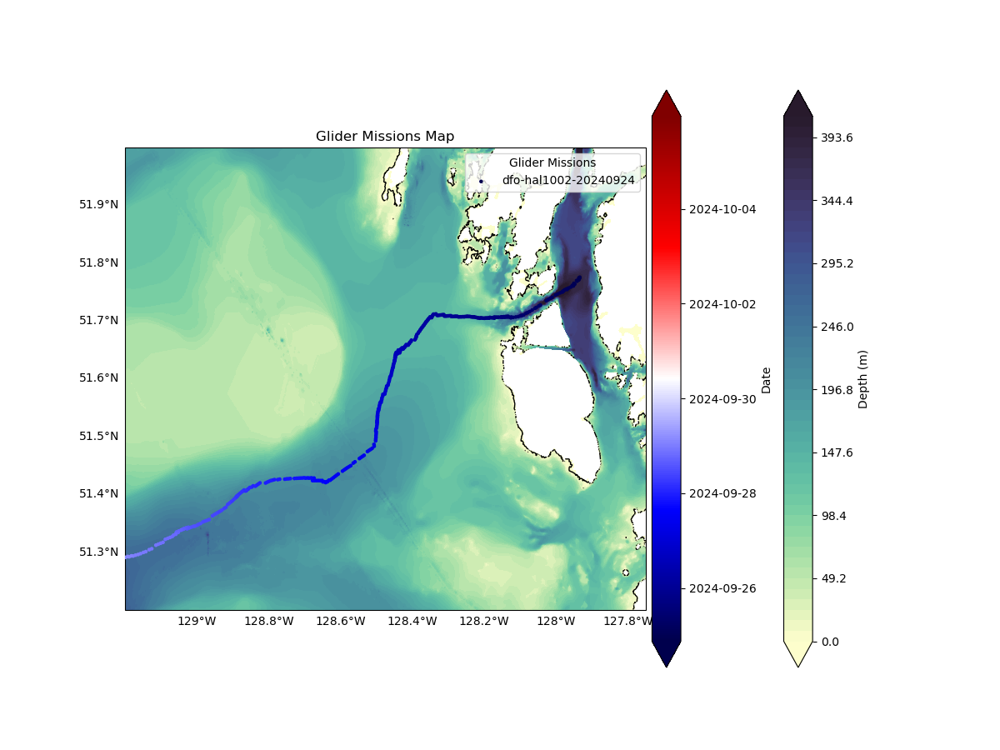

In [8]:
# Comparing some other file
file_pathway = ('~/CalvertLine/dfo-hal1002-20240924_grid_delayed.nc')
ds = xr.open_dataset(file_pathway)
plot_multiple_missions_map([file_pathway], lat_bounds=(51.2, 52), long_bounds=(-129.2, -127.75))

waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
central_lat = 51.715

# Get along/across transect distances
alongx, acrossx, _ = wd.get_simple_distance(
    shiplon=ds['longitude'].values,
    shiplat=ds['latitude'].values,
    wplon=waypoint_lon,
    wplat=waypoint_lat,
    central_lat=central_lat)

# Add to dataset
ds = ds.assign(along=('time', alongx))
ds = ds.assign(across=('time', acrossx))
gradient_along = np.gradient(alongx)
gradient_along

Processing: dfo-bb046-20200717_grid_delayed.nc
Processing: dfo-bb046-20200810_grid_delayed.nc
Processing: dfo-bb046-20200908_grid_delayed.nc
Processing: dfo-bb046-20201006_grid_delayed.nc
Processing: dfo-bb046-20201103_grid_delayed.nc
Processing: dfo-bb046-20210212_grid_delayed.nc
Processing: dfo-bb046-20210324_grid_delayed.nc
Processing: dfo-bb046-20210413_grid_delayed.nc
Processing: dfo-bb046-20210511_grid_delayed.nc
Processing: dfo-bb046-20220507_grid.nc
Processing: dfo-bb046-20220608_grid_delayed.nc
Processing: dfo-bb046-20220707_grid_delayed.nc
Processing: dfo-colin1142-20240312_grid_delayed.nc


/var/folders/w3/xmmx3z314913xcdb0jf7m8h40000gn/T/ipykernel_3012/973000254.py:47: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 9), subplot_kw={'projection': ccrs.PlateCarree()})


Processing: dfo-eva035-20190612_grid_delayed.nc
Processing: dfo-eva035-20230518_grid_delayed.nc
Processing: dfo-eva035-20230620_grid_delayed.nc
Processing: dfo-eva035-20230720_grid_delayed.nc
Processing: dfo-eva035-20230811_grid_delayed.nc
Processing: dfo-eva035-20230915_grid_delayed.nc
Processing: dfo-eva035-20231019_grid_delayed.nc
Processing: dfo-hal1002-20220804_grid_delayed.nc
Processing: dfo-hal1002-20220914_grid_delayed.nc
Processing: dfo-hal1002-20240702_grid_delayed.nc
Processing: dfo-hal1002-20240723_grid_delayed.nc
Processing: dfo-hal1002-20240924_grid_delayed.nc
Processing: dfo-hal1002-20250311_grid_delayed.nc
Processing: dfo-hal1002-20250506_grid.nc
Processing: dfo-k999-20230320_grid_delayed.nc
Processing: dfo-k999-20230418_grid_delayed.nc
Processing: dfo-k999-20230516_grid_delayed.nc
Processing: dfo-k999-20230811_grid_delayed.nc
Processing: dfo-k999-20230915_grid_delayed.nc
Processing: dfo-k999-20241023_grid_delayed.nc
Processing: dfo-k999-20241119_grid_delayed.nc
Process

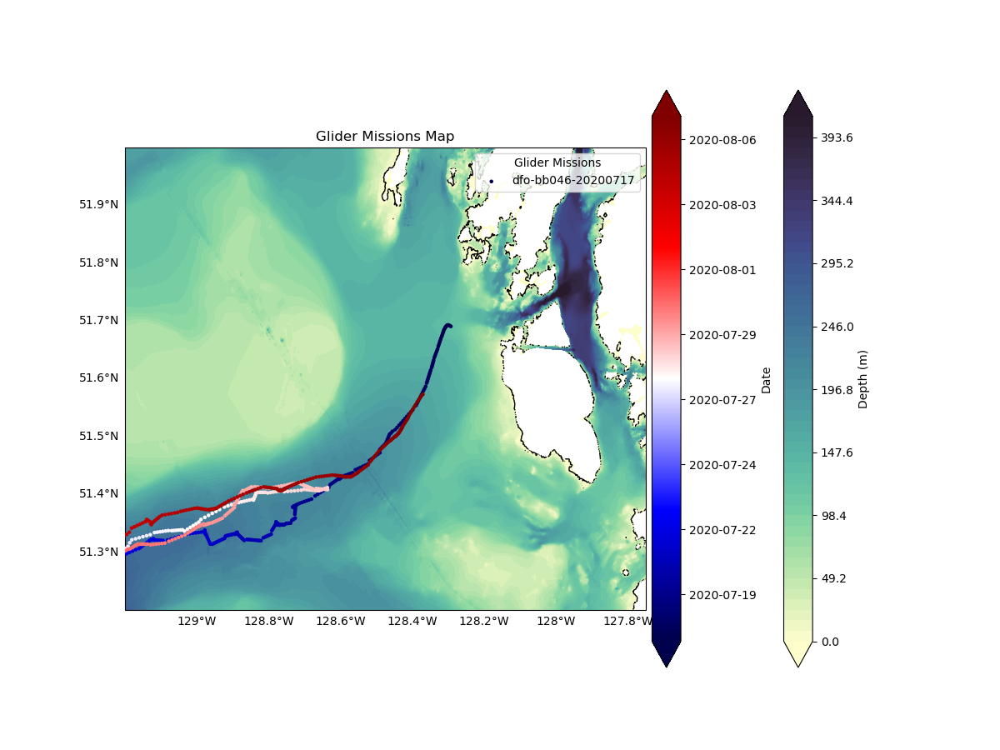

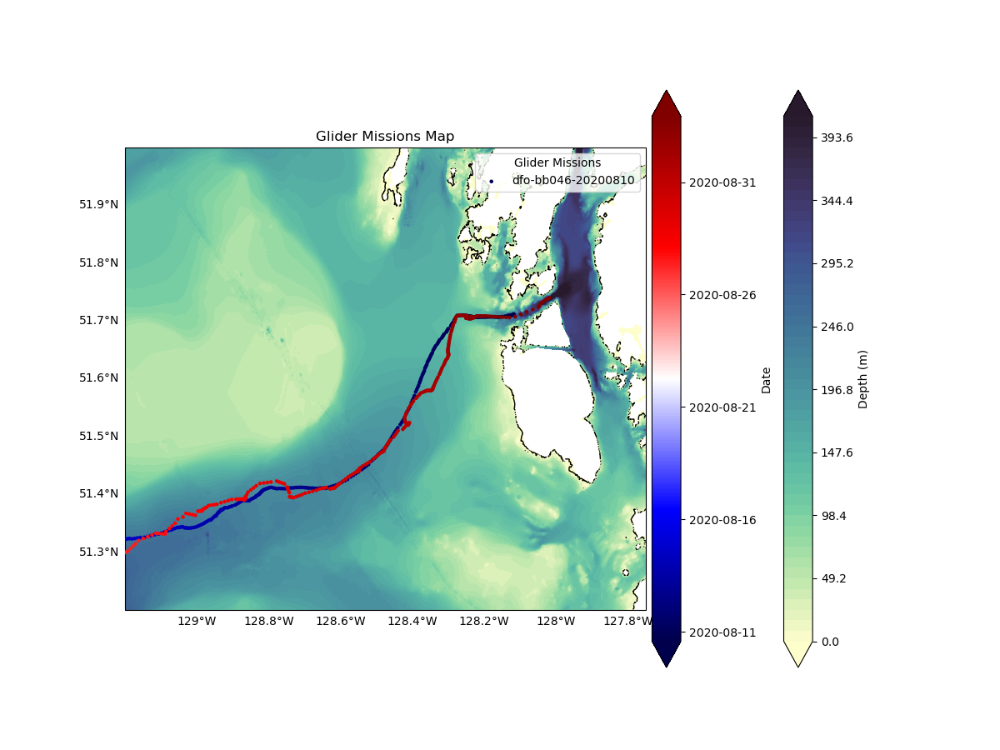

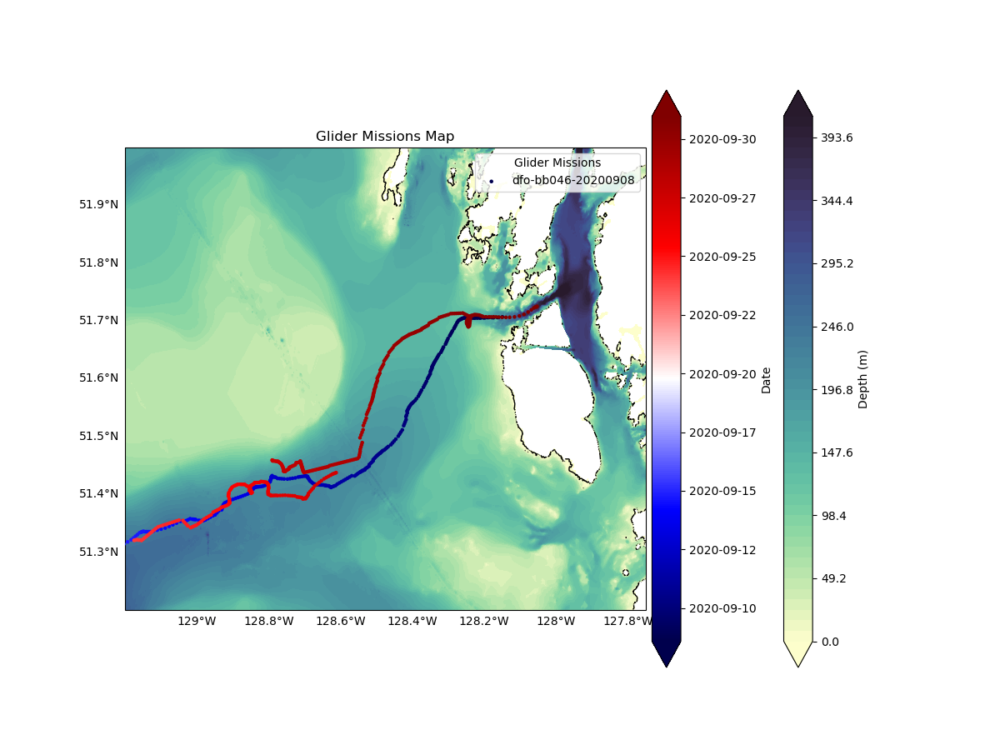

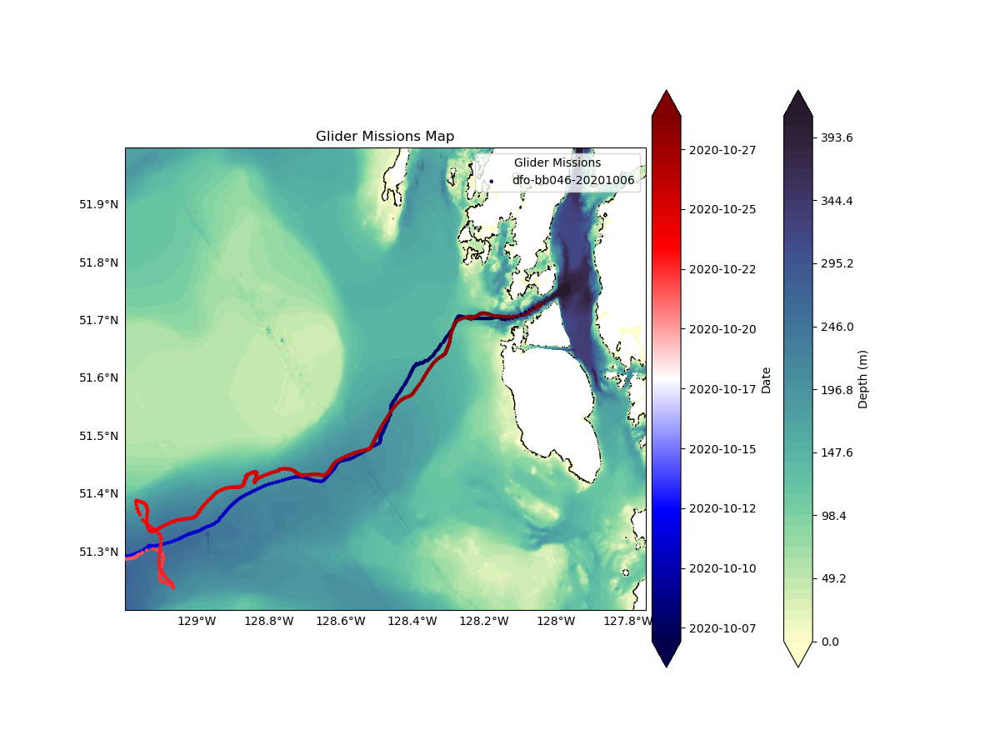

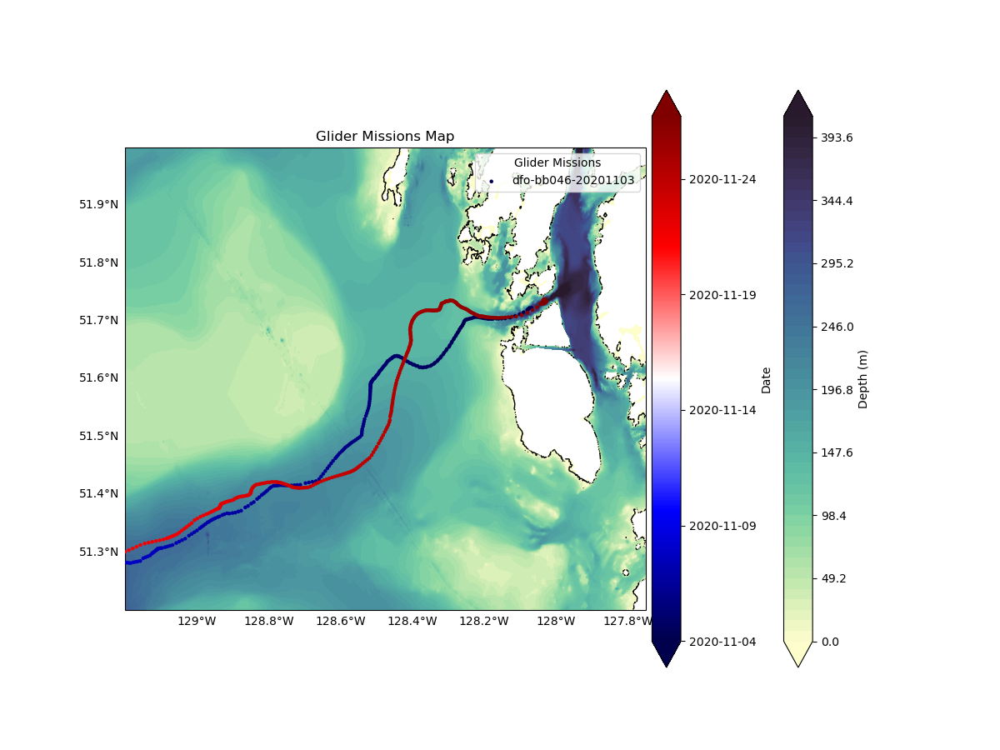

...

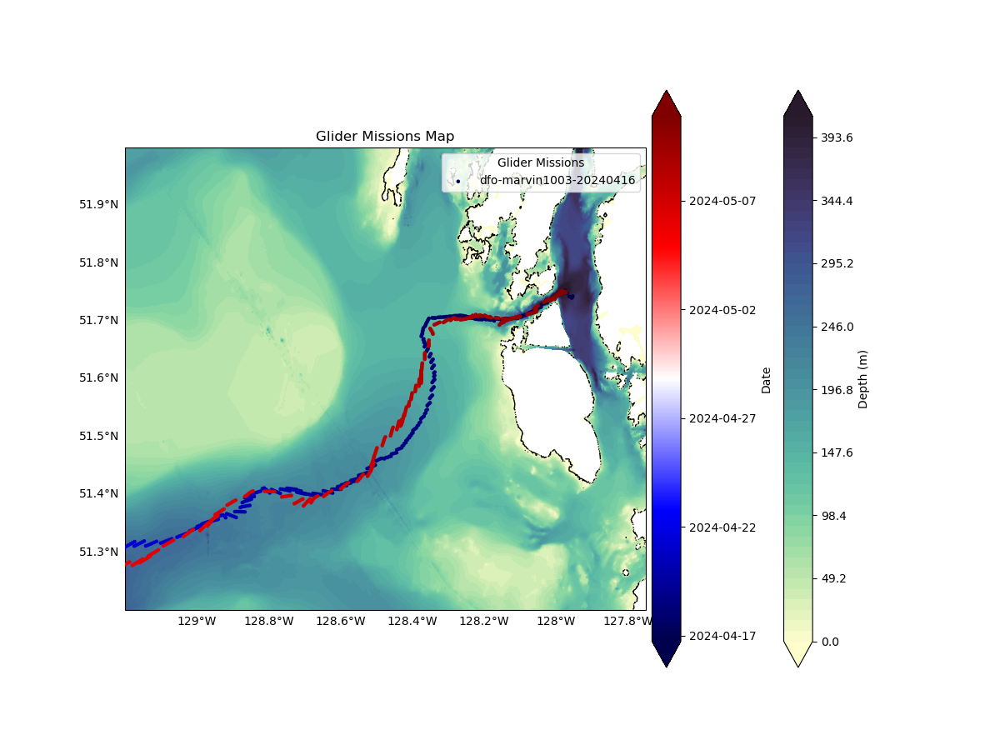

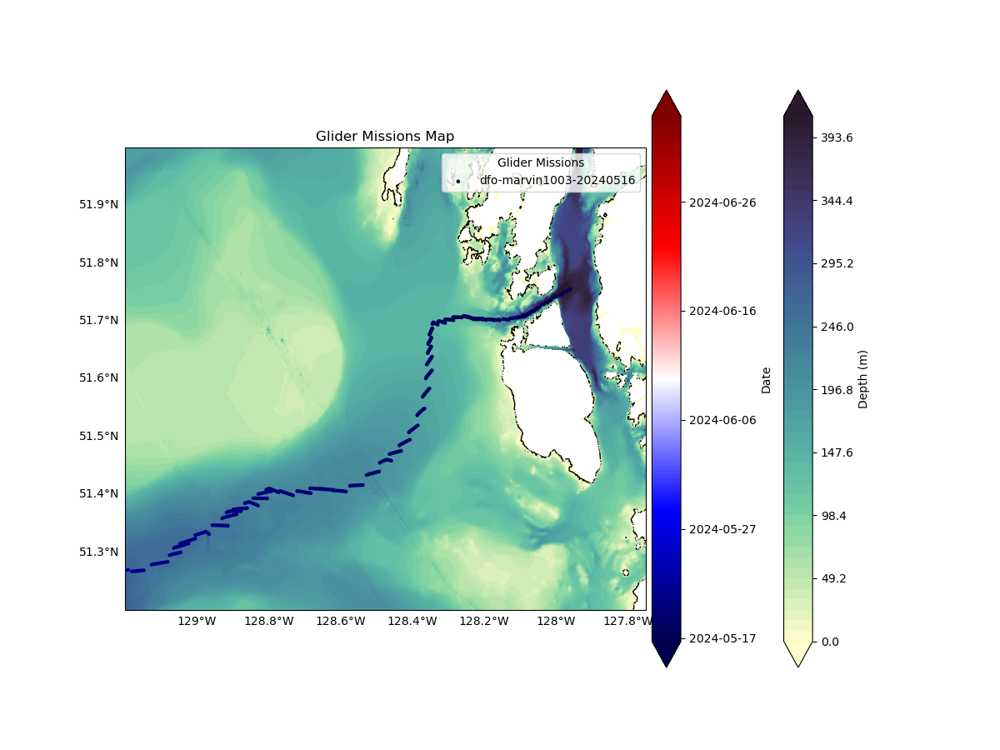

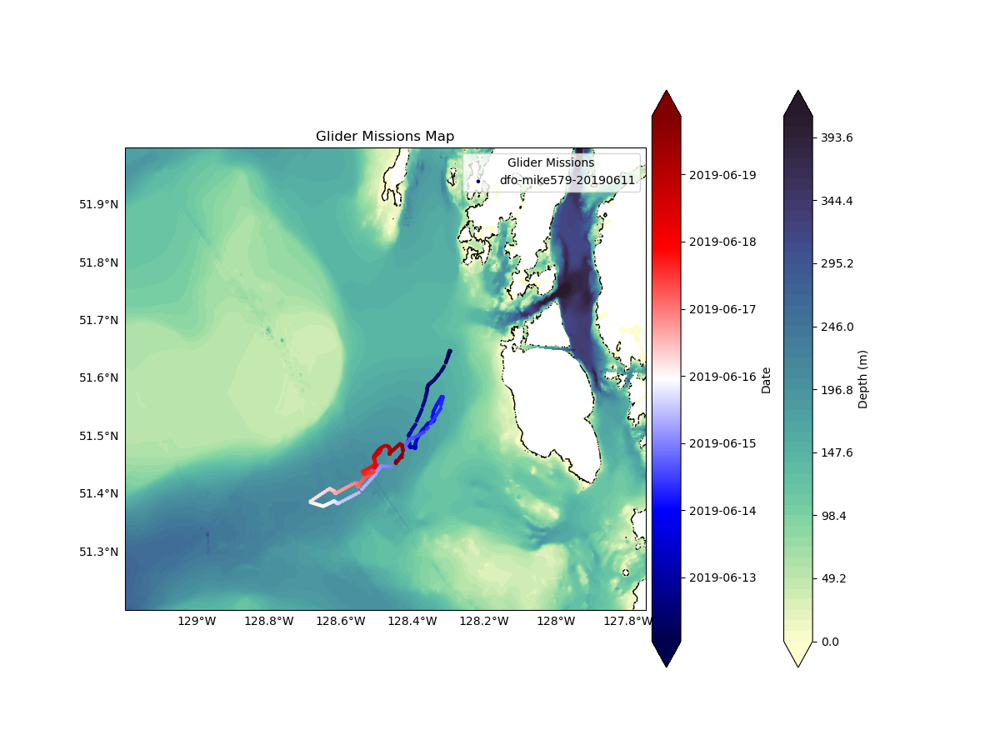

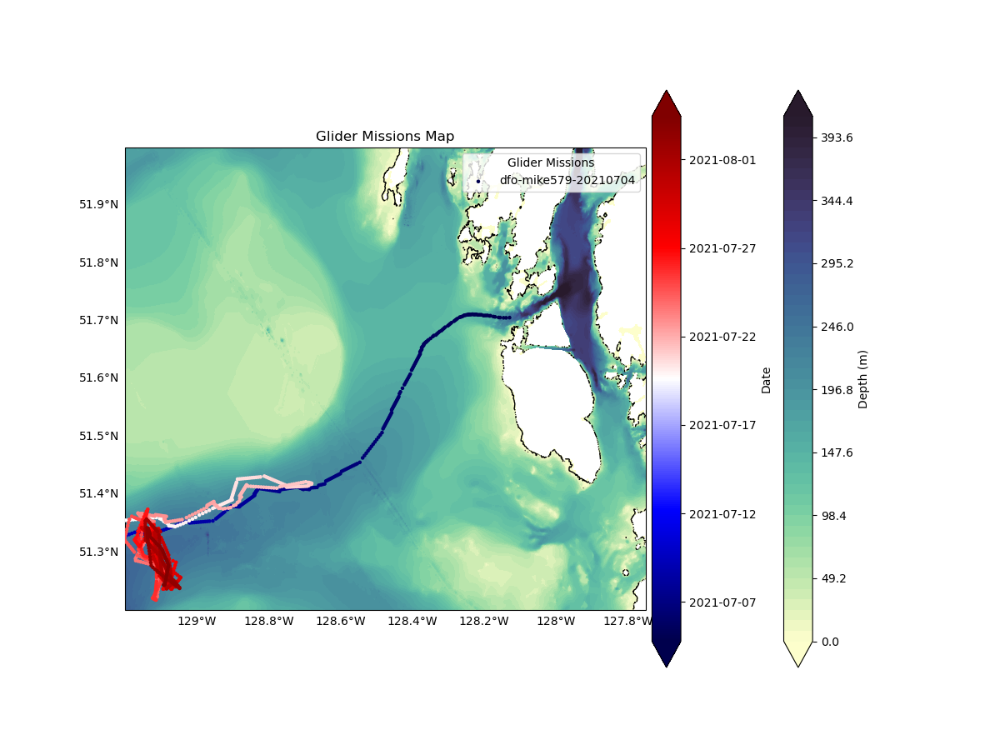

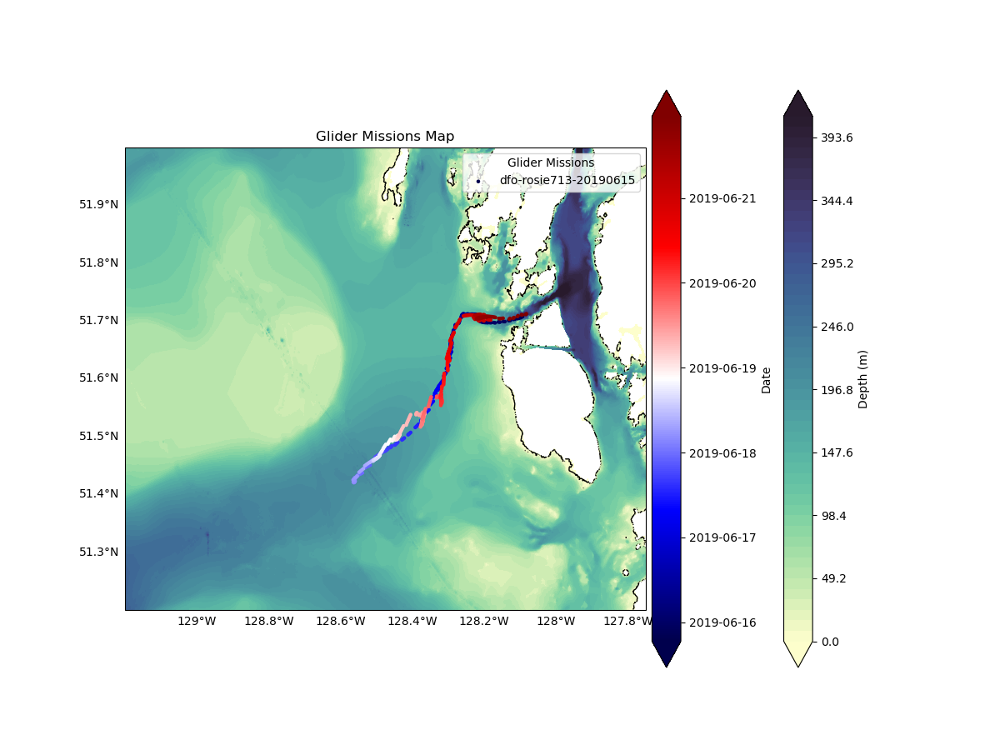

In [9]:
# Form CHATGPT
import xarray as xr
import numpy as np
import os
import glob

def process_calvert_files(directory='~/CalvertLine/'):
    directory = os.path.expanduser(directory)
    file_paths = sorted(glob.glob(os.path.join(directory, '*.nc')))
    file_paths = [f for f in file_paths if '/dfo-' in f]

    # Define waypoint coordinates
    waypoint_lon = np.array([-127.950, -128.115, -128.243, -128.514, -128.646, -128.798])
    waypoint_lat = np.array([51.757, 51.705, 51.715, 51.450, 51.4165, 51.408])
    central_lat = 51.715

    results = {}

    for file_path in file_paths:
        print(f"Processing: {os.path.basename(file_path)}")

        ds = xr.open_dataset(file_path)

        # Get along/across transect distances
        alongx, acrossx, _ = wd.get_simple_distance(
            shiplon=ds['longitude'].values,
            shiplat=ds['latitude'].values,
            wplon=waypoint_lon,
            wplat=waypoint_lat,
            central_lat=central_lat
        )

        # Add to dataset
        ds = ds.assign(along=('time', alongx))
        ds = ds.assign(across=('time', acrossx))

        # Optional: plot
        plot_multiple_missions_map([file_path], lat_bounds=(51.2, 52), long_bounds=(-129.2, -127.75))

        # Calculate gradient of along-track distance
        gradient_along = np.gradient(alongx)

        # Store results
        results[os.path.basename(file_path)] = {
            'along': alongx,
            'gradient_along': gradient_along
        }

    return results

# Run it
results = process_calvert_files()

# Example: Access result for a specific file
for fname, data in results.items():
    print(f"\n--- {fname} ---")
    print("Along:", data['along'][:5])
    print("Gradient Along:", data['gradient_along'][:5])


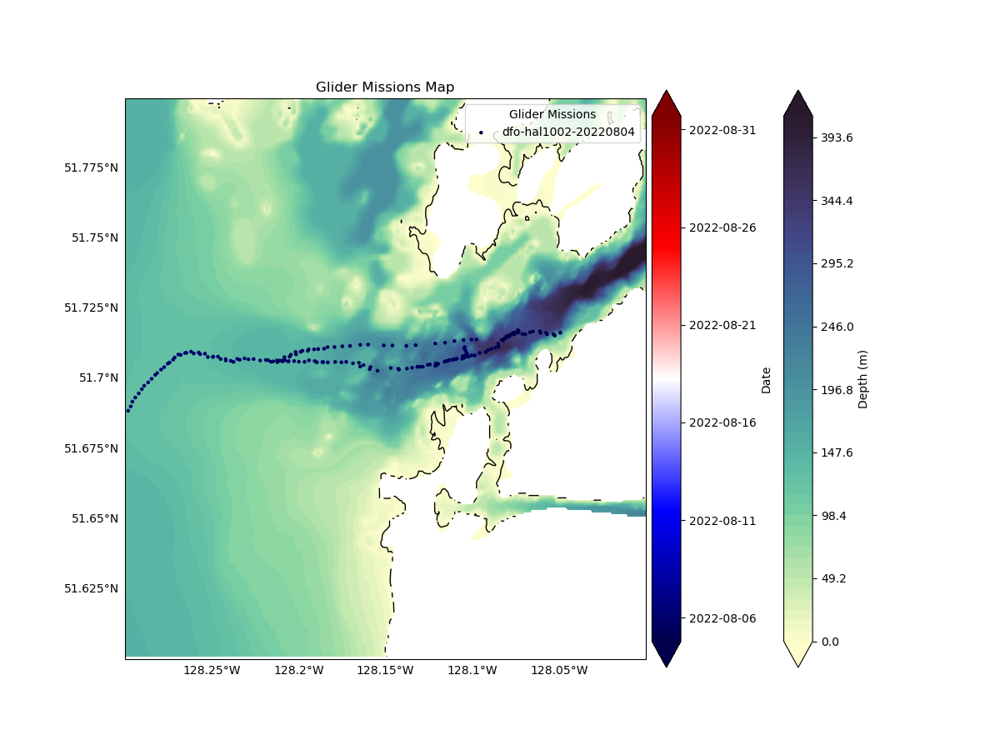

In [17]:
plot_multiple_missions_map(['~/CalvertLine/dfo-hal1002-20220804_grid_delayed.nc'], long_bounds=(-128.3, -128), lat_bounds = (51.6, 51.8), )